### Weekly Dataset

Each week, I'm dedicating myself to exploring, modeling, and doing stuff with a dataset. Trying to master different modalities and such while reviewing different statistical tests I don't use as often as I should.

This week, we're looking at a relatively same dataset of images. These images contain guns and we want to not detect them, but where they are in the image itself.

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()

from glob import glob
import os
from pathlib import Path

%matplotlib inline

Unlike the first two weeks where we had data in a tabluar format, this week has image data. Image data inherently has less structure. Unless you're dealing with <a href="https://en.wikipedia.org/wiki/MNIST_database#:~:text=The%20MNIST%20database%20(Modified%20National,the%20field%20of%20machine%20learning.">MNIST data</a>, a tablular format is not normal. In general, the image will usually reside in a folder. Sometimes, you'll get lucky and the folder has subfolders for train and test sets. You might also get lucky and have a dataframe that has the image path, whether its in the train or test set, and the label.

Here though, we get to do all that from scratch. This dataset is pretty good though and comes from <a href="https://www.linkedin.com/in/saisasanky/">Sai Sasanky</a> through <a href="https://www.kaggle.com/datasets/issaisasank/guns-object-detection">kaggle</a>. Images were taken from Google images with a full data description below:

> Images folder has images in jpeg format. Labels folder has txt files where in each file, the first line contains the number of objects in the corresponding image and the next lines contain the co-ordinates of the box describing the object.

From this, we'll start by doing some image exploring and reorganizing everything for training down the line.

### Read Data and EDA

In [3]:
# get main directory path
dir_path = Path("/kaggle/input/guns-object-detection")

In [4]:
# get all image files
imgs_files = [path for path in (dir_path / "Images").glob("*.jpeg")]

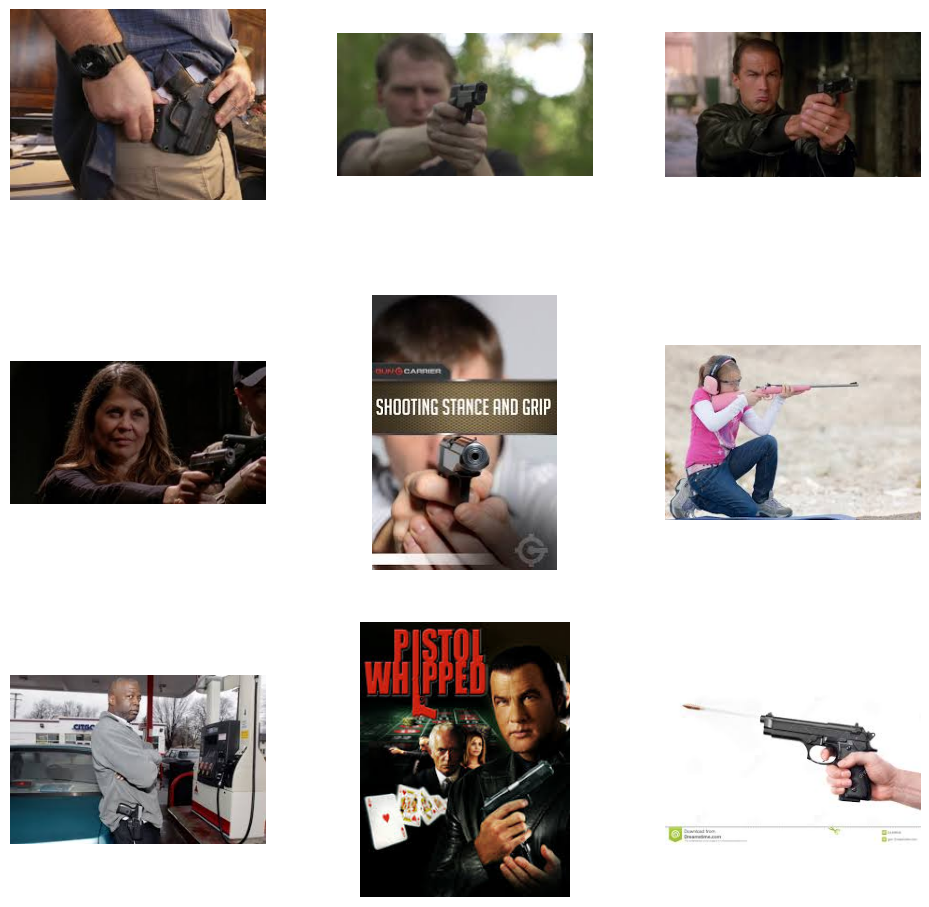

In [5]:
# take a look at the first 9 images
rows, cols = (3, 3)
fig, ax = plt.subplots(rows, cols, figsize=(10,10))

plt.tight_layout()

i = 0
for row in range(rows):
    for col in range(cols):
        ax[row][col].axis("off")
        ax[row][col].imshow(plt.imread(imgs_files[i]))
        i += 1

From these nine images, we can see they range from explicit to more subtle. The photo in the bottom left has a gun in a holster. The bottom right photo makes the gun standout in the center of the image with no other objects to distract us. 

We also see varying angles and types of guns as well. While eight of the nine are handguns, the photo in the middle right is not only a long rifle, it is pink. 

We'll have to take care in doing object detection and do some augmentations as well.

In [6]:
labels = [path for path in (dir_path / "Labels").glob("*.txt")]

In [7]:
labels[:5]

[PosixPath('/kaggle/input/guns-object-detection/Labels/40.txt'),
 PosixPath('/kaggle/input/guns-object-detection/Labels/245.txt'),
 PosixPath('/kaggle/input/guns-object-detection/Labels/44.txt'),
 PosixPath('/kaggle/input/guns-object-detection/Labels/141.txt'),
 PosixPath('/kaggle/input/guns-object-detection/Labels/333.txt')]

In [8]:
from collections import defaultdict

bounding_boxes = defaultdict(list)

for label in labels:
    with open(label, "r") as f:
        label_id = label._str.split("/")[-1].split(".")[0]
        for i, line in enumerate(f.readlines()):
            if i == 0:
                pass
            else:
                bounding_boxes[label_id].append(line.split())

In [9]:
# test to see if data worked
bounding_boxes["1"]

[['76', '45', '146', '87']]

In [10]:
# let's make image have its own dictionary as well, and them create our
# own dataframe with this info


In [11]:
# let's take a look at the bounding of one image

In [12]:
# 
img_dict = defaultdict(list)

for path in Path(dir_path / "Images").glob("*.jpeg"):
    idx = str(path).split("/")[-1].split(".")[0]
    img_dict[idx] = str(path)

In [13]:
img_df = pd.DataFrame({"id": img_dict.keys(),
                       "img_path": img_dict.values()})

In [14]:
label_df = pd.DataFrame({"id": bounding_boxes.keys(),
                         "labels": bounding_boxes.values()})

In [15]:
label_df["num_labels"] = label_df["labels"].apply(len)

In [16]:
total_df = img_df.merge(label_df, on="id", how="inner")

In [17]:
total_df

,id,img_path,labels,num_labels
0,266,/kaggle/input/guns-object-detection/Images/266...,"[[139, 50, 212, 154]]",1
1,14,/kaggle/input/guns-object-detection/Images/14....,"[[128, 58, 181, 110]]",1
2,55,/kaggle/input/guns-object-detection/Images/55....,"[[177, 51, 229, 76]]",1
3,228,/kaggle/input/guns-object-detection/Images/228...,"[[206, 95, 264, 131]]",1
4,130,/kaggle/input/guns-object-detection/Images/130...,"[[45, 141, 124, 207]]",1
...,...,...,...,...
328,237,/kaggle/input/guns-object-detection/Images/237...,"[[221, 4, 316, 56]]",1
329,261,/kaggle/input/guns-object-detection/Images/261...,"[[94, 65, 139, 88], [238, 29, 271, 63]]",2
330,313,/kaggle/input/guns-object-detection/Images/313...,"[[128, 34, 170, 72]]",1
331,201,/kaggle/input/guns-object-detection/Images/201...,"[[81, 69, 143, 106]]",1


In [18]:
# most only have 1 label. Few have two labels. Let's take a look at that
# image with 12 labels
print(total_df.num_labels.value_counts())
print()
print(total_df.num_labels.value_counts() / total_df.shape[0])

num_labels
1     268
2      54
3       7
4       2
11      1
12      1
Name: count, dtype: int64

num_labels
1     0.804805
2     0.162162
3     0.021021
4     0.006006
11    0.003003
12    0.003003
Name: count, dtype: float64


In [19]:
crazy_img = total_df \
.loc[total_df["num_labels"] == 12] \
.reset_index(drop=True) \
.loc[0, "img_path"]

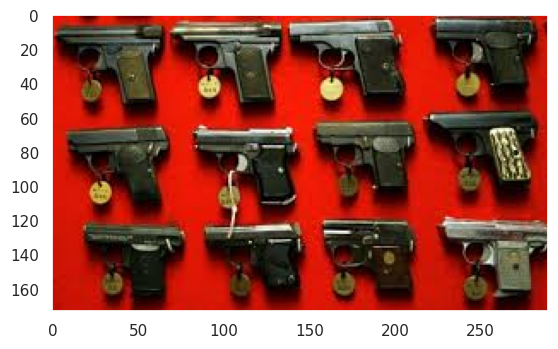

In [20]:
# wow that makes sense
plt.grid(False)
plt.imshow(plt.imread(crazy_img))

In [21]:
# take a look at one bound box
normal_img, bb = total_df \
.loc[total_df["num_labels"] == 1] \
.reset_index(drop=True) \
.loc[0, ["img_path", "labels"]]

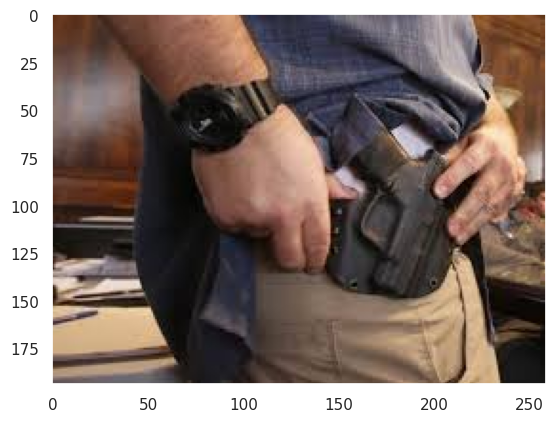

In [22]:
# normal image view
plt.grid(False)
plt.imshow(plt.imread(normal_img))

In [23]:
from typing import Any, List, Tuple
from matplotlib.patches import Rectangle

def show_bounding_box(image_path: str,
                      bounding_boxes: List[List[str]]) -> None:
    
    fig, ax = plt.subplots()
    plt.grid(False)
    ax.imshow(plt.imread(image_path))
    
    for bounding_box in bounding_boxes:
        numeric_bb = [float(point) for point in bounding_box]
        print(numeric_bb)
        rec = Rectangle(
            (numeric_bb[0], numeric_bb[1]),
            numeric_bb[3] - numeric_bb[1],
            numeric_bb[2] - numeric_bb[0],
            linewidth=5, 
            edgecolor="r", 
            facecolor="none")
        ax.add_patch(rec)
        
    plt.show()

[139.0, 50.0, 212.0, 154.0]


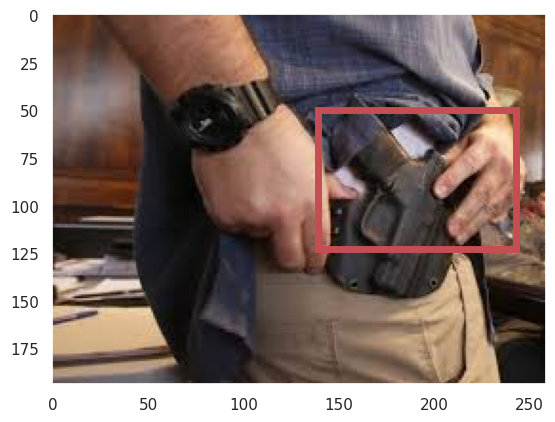

In [24]:
show_bounding_box(normal_img, bb)

In [25]:
total_df.head()

,id,img_path,labels,num_labels
0,266,/kaggle/input/guns-object-detection/Images/266...,"[[139, 50, 212, 154]]",1
1,14,/kaggle/input/guns-object-detection/Images/14....,"[[128, 58, 181, 110]]",1
2,55,/kaggle/input/guns-object-detection/Images/55....,"[[177, 51, 229, 76]]",1
3,228,/kaggle/input/guns-object-detection/Images/228...,"[[206, 95, 264, 131]]",1
4,130,/kaggle/input/guns-object-detection/Images/130...,"[[45, 141, 124, 207]]",1


[139.0, 50.0, 212.0, 154.0]


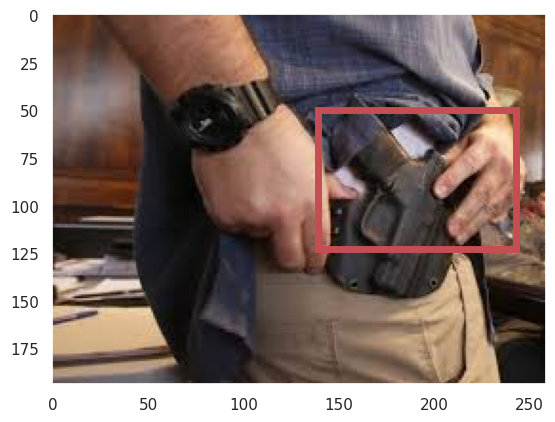

[128.0, 58.0, 181.0, 110.0]


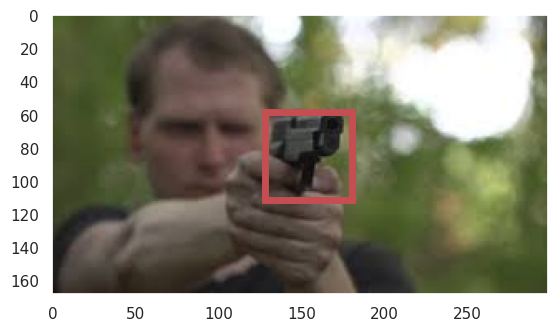

[177.0, 51.0, 229.0, 76.0]


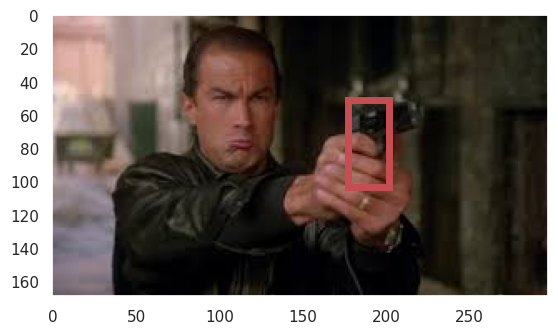

[206.0, 95.0, 264.0, 131.0]


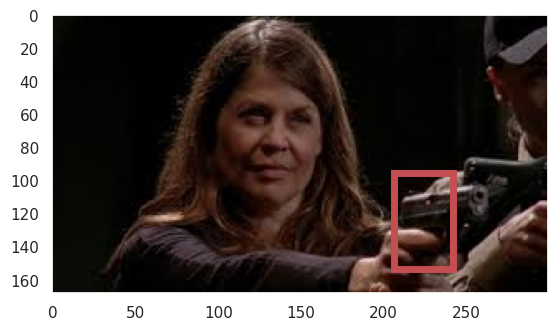

[45.0, 141.0, 124.0, 207.0]


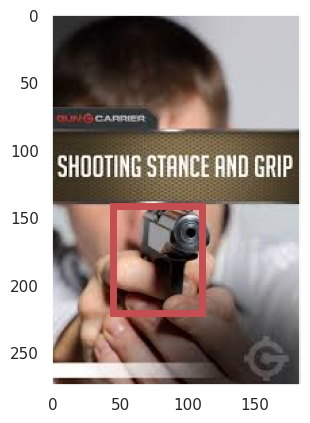

[70.0, 32.0, 212.0, 67.0]


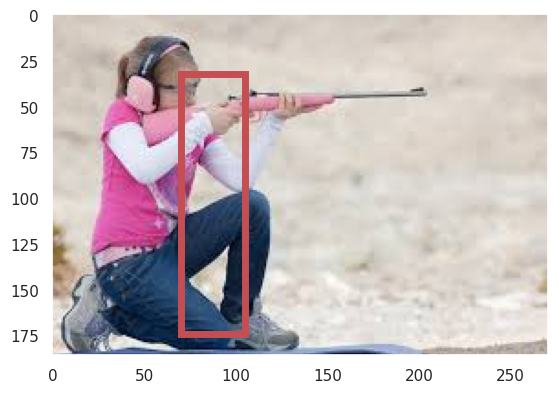

[111.0, 139.0, 149.0, 179.0]


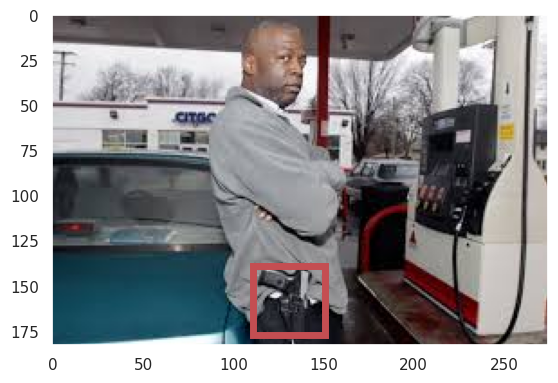

[100.0, 123.0, 185.0, 184.0]


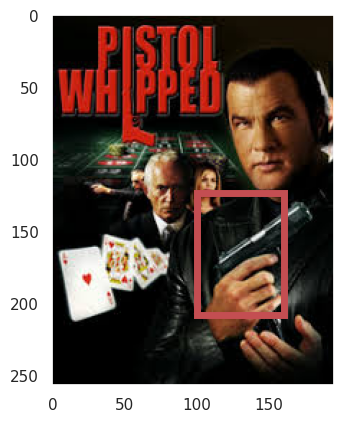

[101.0, 35.0, 233.0, 115.0]


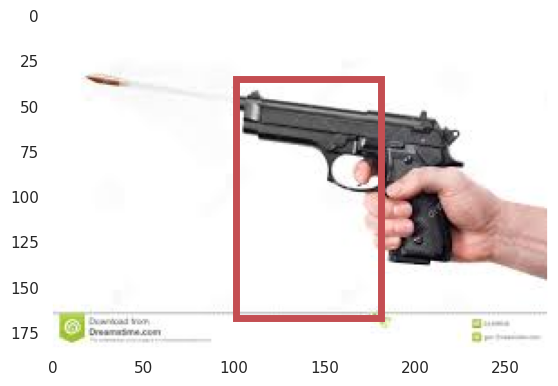

[77.0, 65.0, 253.0, 143.0]


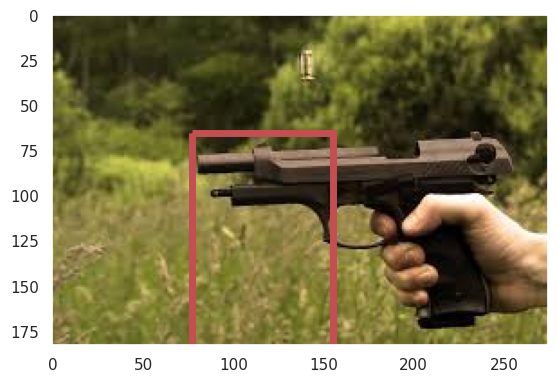

[181.0, 113.0, 210.0, 147.0]
[56.0, 124.0, 83.0, 158.0]


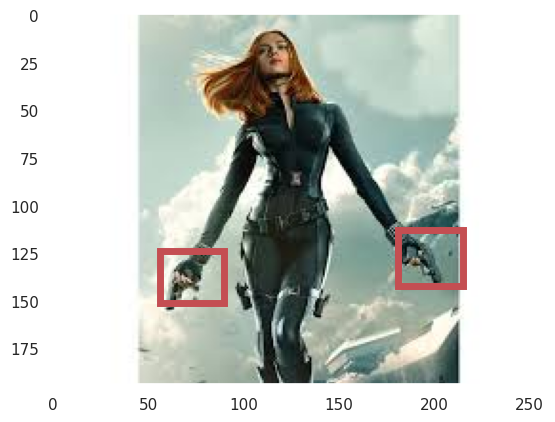

In [26]:
# now that we got a function, let's do that for all 9 of our images from our df
for i,row in total_df.iterrows():
    show_bounding_box(row["img_path"], row["labels"])
    if i > 9:
        break

Those bounding boxes don't look...right? Normally, you have [x_min, y_min, x_max, y_max], however, I think I may have inverted something? Let's look at this again:

In [27]:
# rewrite our function
def show_bounding_box(image_path: str,
                      bounding_boxes: List[List[str]]) -> None:
    
    fig, ax = plt.subplots()
    plt.grid(False)
    ax.imshow(plt.imread(image_path))
    
    for bounding_box in bounding_boxes:
        numeric_bb = [float(point) for point in bounding_box]
        print(numeric_bb)
        rec = Rectangle(
            (numeric_bb[0], numeric_bb[1]),
            numeric_bb[2] - numeric_bb[0],
            numeric_bb[3] - numeric_bb[1],
            linewidth=5, 
            edgecolor="r", 
            facecolor="none")
        ax.add_patch(rec)
        
    plt.show()

[139.0, 50.0, 212.0, 154.0]


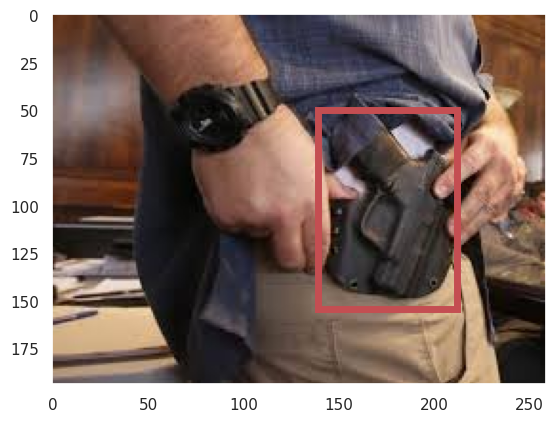

[128.0, 58.0, 181.0, 110.0]


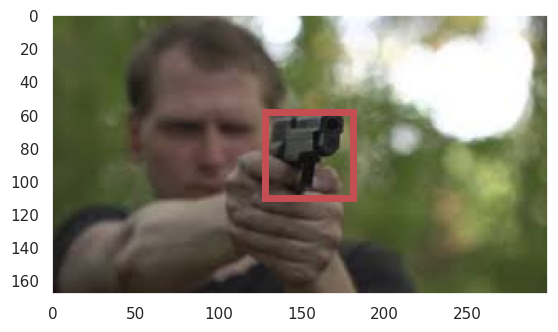

[177.0, 51.0, 229.0, 76.0]


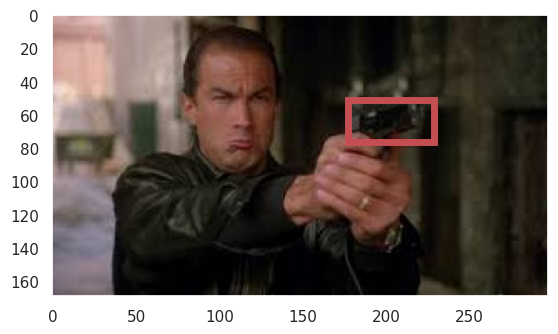

[206.0, 95.0, 264.0, 131.0]


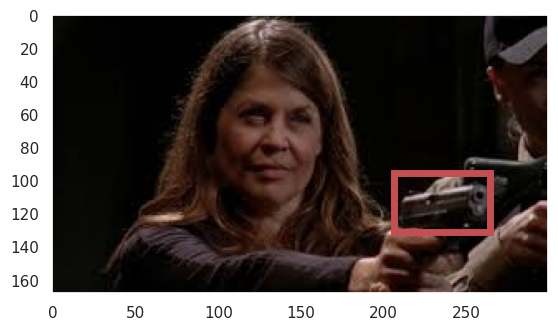

[45.0, 141.0, 124.0, 207.0]


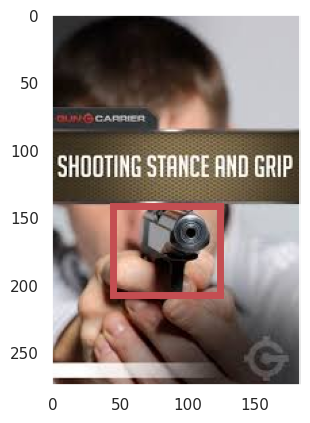

[70.0, 32.0, 212.0, 67.0]


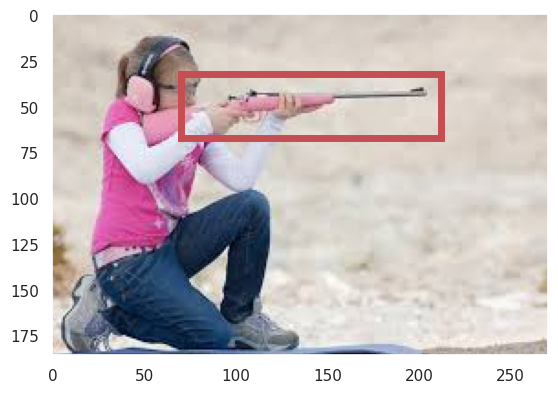

[111.0, 139.0, 149.0, 179.0]


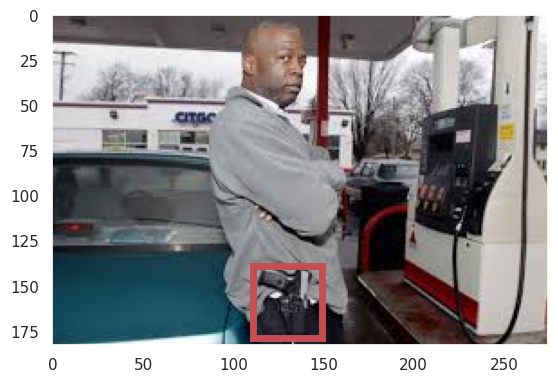

[100.0, 123.0, 185.0, 184.0]


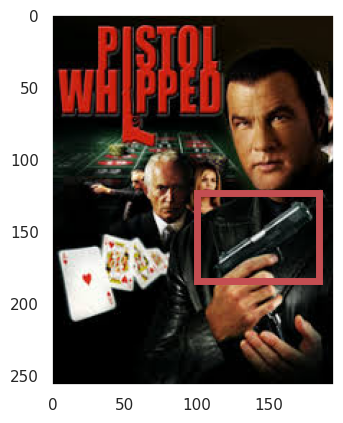

[101.0, 35.0, 233.0, 115.0]


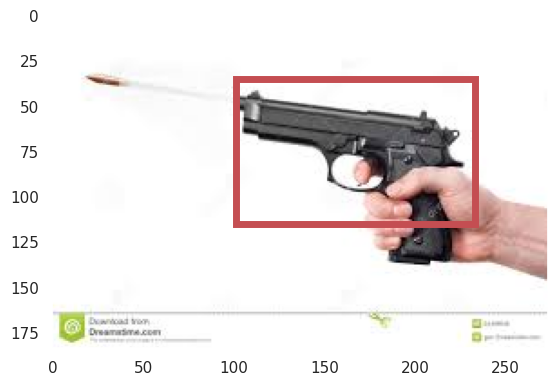

[77.0, 65.0, 253.0, 143.0]


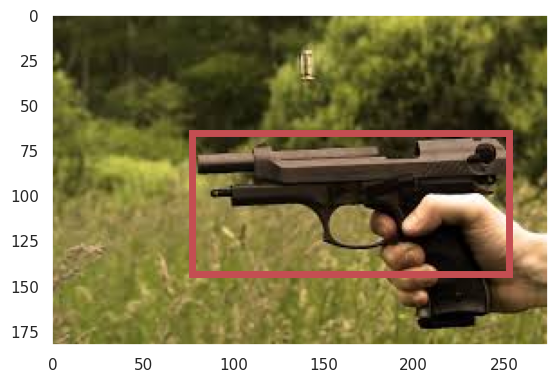

[181.0, 113.0, 210.0, 147.0]
[56.0, 124.0, 83.0, 158.0]


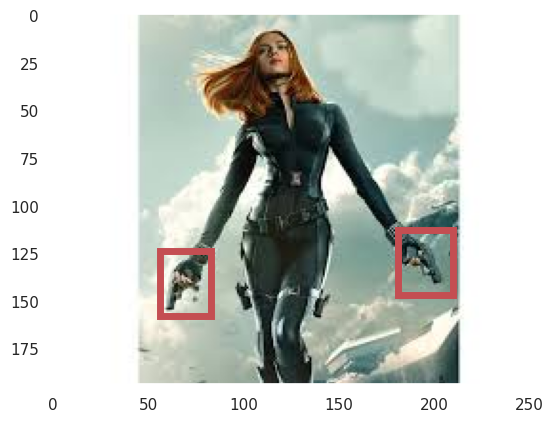

In [28]:
# take another look
for i,row in total_df.iterrows():
    show_bounding_box(row["img_path"], row["labels"])
    if i > 9:
        break

In [29]:
# take a look at our Rectangle Object
Rectangle??

Init signature: Rectangle(xy, width, height, *, angle=0.0, rotation_point='xy', **kwargs)
Source:        
class Rectangle(Patch):
    """
    A rectangle defined via an anchor point *xy* and its *width* and *height*.

    The rectangle extends from ``xy[0]`` to ``xy[0] + width`` in x-direction
    and from ``xy[1]`` to ``xy[1] + height`` in y-direction. ::

      :                +------------------+
      :                |                  |
      :              height               |
      :                |                  |
      :               (xy)---- width -----+

    One may picture *xy* as the bottom left corner, but which corner *xy* is
    actually depends on the direction of the axis and the sign of *width*
    and *height*; e.g. *xy* would be the bottom right corner if the x-axis
    was inverted or if *width* was negative.
    """

    def __str__(self):
        pars = self._x0, self._y0, self._width, self._height, self.angle
        fmt = "Rectangle(xy=(%g, %g), width

Ahhhh. So it's your anchor point, width, and then height. I swapped them. This should fix it.

Cool. Now we need the harder job doing object detection. 300 images aint a lot for training data. Let's just start with something out of the box. 

YOLO it shall be!

### Use Prepackaged Solution

<a href="https://pjreddie.com/darknet/yolo/">YOLO</a> is an object detection algorithm. I think, as of this writing, we're up to <a href="https://github.com/ultralytics/ultralytics">v8</a> but that's probably going to change eventually and people are up in arms on numbering conventions here.

<a href="https://github.com/ultralytics">Ultralytics</a> took over from my boy (...boy status yet to be determined) <a href="https://pjreddie.com/static/Redmon%20Resume.pdf">PJReddie</a>. They have specific licences now and such, however, we're just doing this for education purposes and fun. I don't think I'll have to owe them money...I think. Plus, there seem to be parallel tracks for YOLO now, too.

Anywho, we're going to simply download a <a href="https://pytorch.org/hub/ultralytics_yolov5/">pre-trained model from the torchhub</a> and start doing it some object detection.

In [30]:
# install ultralytics for inference
!pip install -U ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 644.8/644.8 kB 15.5 MB/s eta 0:00:0000:01


In [31]:
# just repeat code from the hub with our image batches instead
import torch

# Download
model = torch.hub.load("ultralytics/yolov5", "yolov5s", pretrained=True)

# Create our list of images
imgs = total_df["img_path"].tolist()  

# Run Inference
results = model(imgs)

# Get Results
results.print()
results.save()  # or .show()

/opt/conda/lib/python3.10/site-packages/torch/hub.py:286: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip
YOLOv5 🚀 2023-10-31 Python-3.10.12 torch-2.0.0+cpu CPU

100%|██████████| 14.1M/14.1M [00:00<00:00, 149MB/s]

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients
Adding AutoShape... 
image 1/333: 194x259 (no detections)
ima

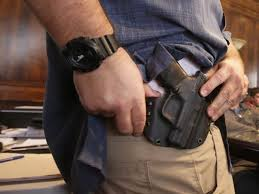

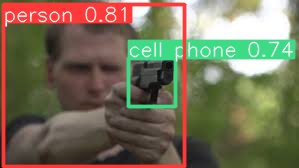

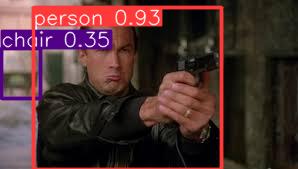

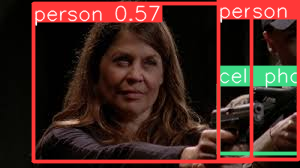

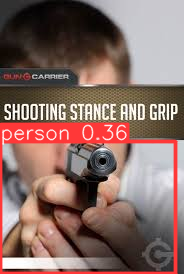

...

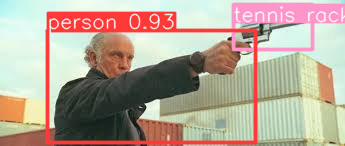

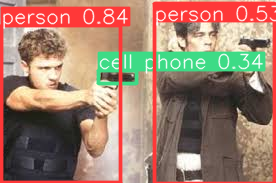

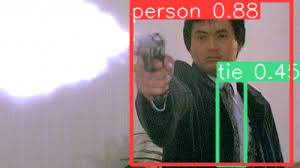

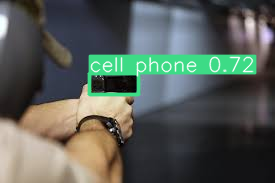

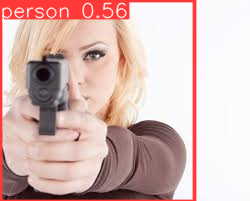

In [32]:
results.show()

Wow. This is like...horrible. Like terrible...well for our task at least. Luckily, we can view all of the examples in this small dataset, but damn, We got work to do.

It seems that gun was never a label in the original datasets.

Ok, so what do we do? Well, we have a bunch of pre-trained models, so maybe we could just do some fine tuning. Let's see what we can do there. First, we'll have to add this new category and train it.

A secondary issue is data duplicates. I did see one with duplicate in there. Might as well add another library to learn. <a href="https://github.com/elisemercury/Duplicate-Image-Finder/tree/main">difPy</a> seems good enough for now.

In [33]:
# install difPy
!pip install difPy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.2/18.2 MB 56.3 MB/s eta 0:00:0000:0100:01
  Attempting uninstall: numpy
    Found existing installation: numpy 1.23.5
    Uninstalling numpy-1.23.5:
      Successfully uninstalled numpy-1.23.5
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
apache-beam 2.46.0 requires dill<0.3.2,>=0.3.1.1, but you have dill 0.3.7 which is incompatible.
apache-beam 2.46.0 requires numpy<1.25.0,>=1.14.3, but you have numpy 1.26.1 which is incompatible.
momepy 0.6.0 requires shapely>=2, but you have shapely 1.8.5.post1 which is incompatible.
numba 0.57.1 requires numpy<1.25,>=1.21, but you have numpy 1.26.1 which is incompatible.
pymc3 3.11.5 requires numpy<1.22.2,>=1.15.0, but you have numpy 1.26.1 which is incompatible.
pymc3 3.11.5 requires scipy<1.8.0,>=1.7.3, but you have scipy 1.11.2 which is incompatible.
tensorflow 2.12.0 re

In [34]:
import difPy
dif = difPy.build([dir_path / "Images"])
search = difPy.search(dif)

difPy preparing files: [100%]
difPy searching files: [100%]


In [35]:
results = search.result

In [36]:
len(results)

29

In [37]:
list(results.items())[0][1]["matches"]

{249240057615860338644254200101465960496: {'location': '/kaggle/input/guns-object-detection/Images/5.jpeg',
  'mse': 0.0}}

In [38]:
image_path = []
for _,v in results.items():
    image_path.append(v["location"])
    image_path.append(list(v["matches"].items())[0][1]["location"])

In [39]:
len(image_path)

58

In [40]:
from matplotlib import gridspec

rows, cols = (len(results), 2)

fig = plt.figure(figsize=(15, 60))
gs = gridspec.GridSpec(rows, cols, height_ratios=[10 for _ in range(len(results))])

for i, p in enumerate(image_path):
    ax = fig.add_subplot(gs[i])
    
    # Load the image
    img = plt.imread(p)
    
    # Display the image with aspect set to "auto"
    ax.imshow(img, aspect="auto")
    
    # Remove axis labels and ticks
    ax.axis("off")

# Reduce spacing between subplots
plt.tight_layout()
plt.show()

These all look identical to me. Let mark the first ones i.e. the image paths on the left to be removed from our dataframe, or rather mark a column with duplicate or not. That way we don't lose data. Note, it's probably best to check for dups during your EDA process.

In [41]:
# filter images to remove only the first version
dup_images = [x[1] for x in filter(lambda x: x[0] % 2 == 0, enumerate(image_path))]

In [42]:
# create the duplicate column 
total_df["duplicate"] = [True if img in dup_images else False for img in total_df["img_path"]]

In [43]:
total_df_no_dups = total_df.loc[total_df["duplicate"] == False].reset_index(drop=True)

In [44]:
total_df_no_dups

,id,img_path,labels,num_labels,duplicate
0,266,/kaggle/input/guns-object-detection/Images/266...,"[[139, 50, 212, 154]]",1,False
1,14,/kaggle/input/guns-object-detection/Images/14....,"[[128, 58, 181, 110]]",1,False
2,55,/kaggle/input/guns-object-detection/Images/55....,"[[177, 51, 229, 76]]",1,False
3,228,/kaggle/input/guns-object-detection/Images/228...,"[[206, 95, 264, 131]]",1,False
4,130,/kaggle/input/guns-object-detection/Images/130...,"[[45, 141, 124, 207]]",1,False
...,...,...,...,...,...
299,237,/kaggle/input/guns-object-detection/Images/237...,"[[221, 4, 316, 56]]",1,False
300,261,/kaggle/input/guns-object-detection/Images/261...,"[[94, 65, 139, 88], [238, 29, 271, 63]]",2,False
301,313,/kaggle/input/guns-object-detection/Images/313...,"[[128, 34, 170, 72]]",1,False
302,201,/kaggle/input/guns-object-detection/Images/201...,"[[81, 69, 143, 106]]",1,False


Reading more into the documentation for YOLO v5, it seems that there are a few options for labels in our models. However, none seem easy to implement. What we'll try, for our own practice, is train a model from scratch. Again, 304 images isn't really a lot, so we might not have good luck, but we can try. 

We'll first need to create our dataset again. This time, we need to create text files that have the format: {class} {x_min} {y_min} {x_max} {y_max} 

Each line in the text file will start with 0 because we'll only have one class: gun. We'll add lines for each bounding box or gun a photo.

To go deeper into how to set up a dataset, please read this <a href="https://github.com/ultralytics/yolov5/wiki/Train-Custom-Datahttps://github.com/ultralytics/yolov5/wiki/Train-Custom-Data">tutorial from ultralytics</a> under "manually prepare your dataset".

In [45]:
from sklearn.model_selection import train_test_split

In [46]:
X_train, X_test, _, _ = train_test_split(total_df_no_dups, 
                                         total_df_no_dups["num_labels"],
                                         test_size=0.15,
                                         random_state=1)

In [47]:
X_train.shape, X_test.shape

((258, 5), (46, 5))

In [48]:
import os

In [49]:
# create data directories
os.mkdir("/kaggle/working/data")

In [50]:
# create more directories for training and validation set
os.mkdir("/kaggle/working/data/training")
os.mkdir("/kaggle/working/data/training/images")
os.mkdir("/kaggle/working/data/training/labels")

os.mkdir("/kaggle/working/data/validation")
os.mkdir("/kaggle/working/data/validation/images/")
os.mkdir("/kaggle/working/data/validation/labels")

In [51]:
# ensure all images have a unique id
len(X_train["id"].unique()) == X_train.shape[0]

True

In [52]:
# to remove gunk
import gc

In [53]:
# per the dataset creation documentation, need to mark images from center of image
# and then provide width and height
def get_yolo_coordinates(x_min, y_min, x_max, y_max, img_width, img_height):
    x_center = ((x_max - x_min) / 2) / img_width
    y_center = ((y_max - y_min) / 2) / img_height
    width = (x_max - x_min) / img_width
    height = (y_max - y_min) / img_height
    
    return x_center, y_center, width, height

In [54]:
# move all the train files to our output dir here in kaggle
for i, row in X_train.iterrows():
    
    img = plt.imread(row["img_path"])
    
    plt.imsave(f"/kaggle/working/data/training/images/{row['id']}.jpeg", 
               img)
    
    for label in row["labels"]:
        with open(f"/kaggle/working/data/training/labels/{row['id']}.txt", "a") as f:
            x_center, y_center, width, height = get_yolo_coordinates(int(label[0]), 
                                                             int(label[1]),
                                                             int(label[2]),
                                                             int(label[3]),
                                                             img.shape[0],
                                                             img.shape[1])
            
            f.write(f"0 {x_center} {y_center} {width} {height}\n")
            
    del img
    gc.collect()

In [55]:
# do the same for validation/test set
for i, row in X_test.iterrows():
    
    img = plt.imread(row["img_path"])
    
    plt.imsave(f"/kaggle/working/data/validation/images/{row['id']}.jpeg", 
               img)
    
    for label in row["labels"]:
        with open(f"/kaggle/working/data/validation/labels/{row['id']}.txt", "a") as f:
            x_center, y_center, width, height = get_yolo_coordinates(int(label[0]), 
                                                             int(label[1]),
                                                             int(label[2]),
                                                             int(label[3]),
                                                             img.shape[0],
                                                             img.shape[1])
            
            f.write(f"0 {x_center} {y_center} {width} {height}\n")
            
    del img
    gc.collect()

In [56]:
#  sizes of each dir look good
len(glob("/kaggle/working/data/training/images/*.jpeg")), \
len(glob("/kaggle/working/data/training/labels/*.txt")), \
len(glob("/kaggle/working/data/validation/images/*.jpeg")), \
len(glob("/kaggle/working/data/validation/labels/*.txt"))

(258, 258, 46, 46)

In [57]:
with open("/kaggle/working/data/dataset.yaml", "w") as f:
    f.write(
    """
    path: /kaggle/working/data/
    train: /kaggle/working/data/training
    val: /kaggle/working/data/validation

    # number of classes
    nc: 1

    # class names
    names: ["gun"]
    """)

In [58]:
!git clone https://github.com/ultralytics/yolov5

Cloning into 'yolov5'...
remote: Enumerating objects: 16031, done.
remote: Counting objects: 100% (64/64), done.
remote: Compressing objects: 100% (39/39), done.
remote: Total 16031 (delta 36), reused 42 (delta 25), pack-reused 15967
Receiving objects: 100% (16031/16031), 14.61 MiB | 30.59 MiB/s, done.
Resolving deltas: 100% (11002/11002), done.


In [59]:
%%sh
python /kaggle/working/yolov5/train.py --img 640 --batch 16 --epoch 5 --data /kaggle/working/data/dataset.yaml --weights /kaggle/working/yolov5s.pt

wandb: WARNING ⚠️ wandb is deprecated and will be removed in a future release. See supported integrations at https://github.com/ultralytics/yolov5#integrations.
train: weights=/kaggle/working/yolov5s.pt, cfg=, data=/kaggle/working/data/dataset.yaml, hyp=yolov5/data/hyps/hyp.scratch-low.yaml, epochs=5, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=yolov5/runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-231-gc2f131a Python-3.10.12 torch-2.0.0+cpu CPU

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, 

In [60]:
from ultralytics import YOLO

# import our best model from training
model = YOLO("/kaggle/working/yolov5/runs/train/exp/weights/best.pt")

In [61]:
%%sh
python /kaggle/working/yolov5/detect.py --weights /kaggle/working/yolov5/runs/train/exp/weights/best.pt --source /kaggle/working/data/validation/images/

detect: weights=['/kaggle/working/yolov5/runs/train/exp/weights/best.pt'], source=/kaggle/working/data/validation/images/, data=yolov5/data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=yolov5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-231-gc2f131a Python-3.10.12 torch-2.0.0+cpu CPU

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/46 /kaggle/working/data/validation/images/117.jpeg: 480x640 (no detections), 183.0ms
image 2/46 /kaggle/working/data/validation/images/122.jpeg: 448x640 (no detections), 154.6ms
image 3/46 /kaggle/working/data/validation/images/129.jpeg: 224x640 (no detections), 87.5ms
image 4/46 /kaggle/wo

Well shoot...that's not good. Not a single detection. Granted, we're not training on a bunch of data. We could try to train longer or we could see what other models we got. Luckily, there's one dataset that was pretrained with "guns" in the label set. 

It's called <a href="https://www.objects365.org/overview.html">Object365</a> and contains 365 classes. Ultralytics does have pretrained weights, so let's use those.

In [62]:
%%sh
python /kaggle/working/yolov5/detect.py --weights https://github.com/ultralytics/yolov5/releases/download/v6.0/yolov5m_Objects365.pt --source /kaggle/working/data/validation/images/

detect: weights=['https://github.com/ultralytics/yolov5/releases/download/v6.0/yolov5m_Objects365.pt'], source=/kaggle/working/data/validation/images/, data=yolov5/data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=yolov5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-231-gc2f131a Python-3.10.12 torch-2.0.0+cpu CPU

100%|██████████| 43.0M/43.0M [00:00<00:00, 212MB/s]

Fusing layers... 
YOLOv5m summary: 290 layers, 22323858 parameters, 0 gradients
image 1/46 /kaggle/working/data/validation/images/117.jpeg: 480x640 1 Person, 743.1ms
image 2/46 /kaggle/working/data/validation/images/122.jpeg: 448x640 2 Persons, 2 Guns, 696.6ms
image 3/46 /kaggle/working/data/validation/ima

In [81]:
detected_imgs = glob("/kaggle/working/yolov5/runs/detect/exp2/*.jpeg")

In [82]:
len(detected_imgs)

46

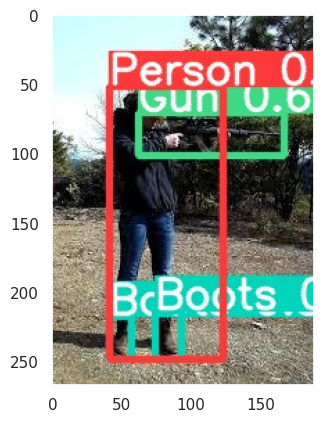

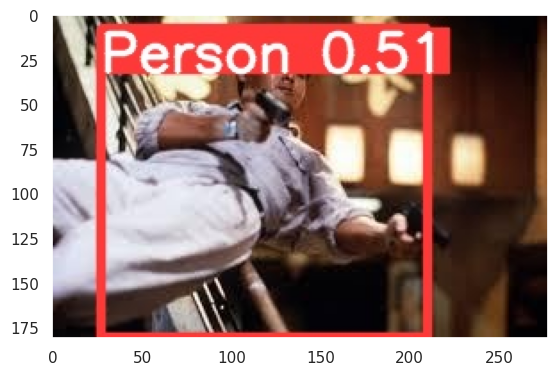

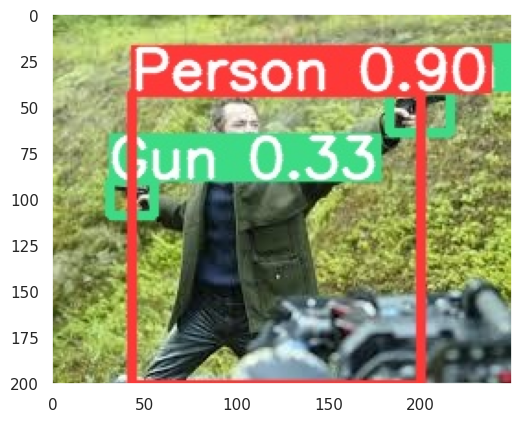

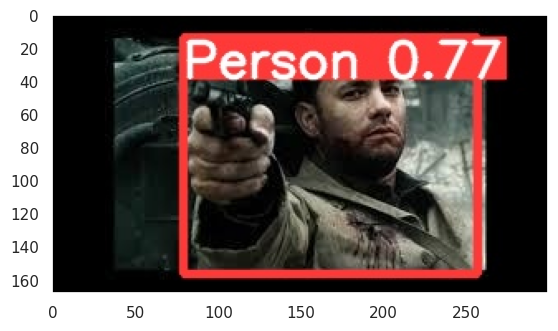

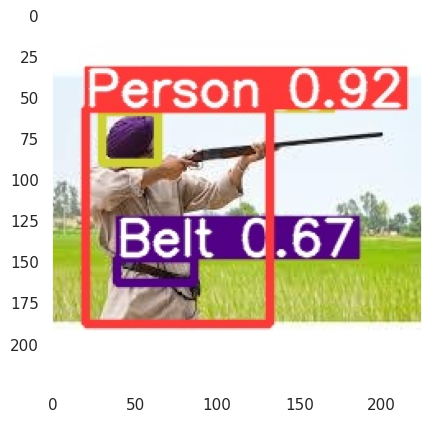

...

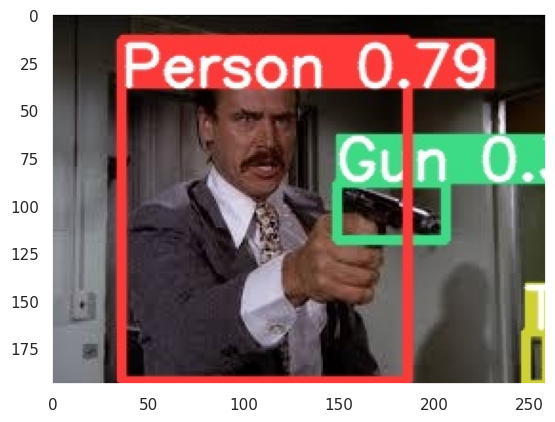

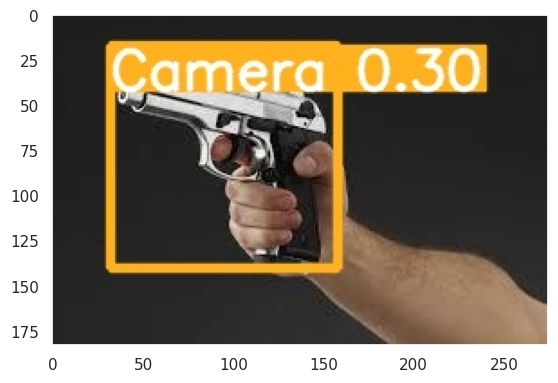

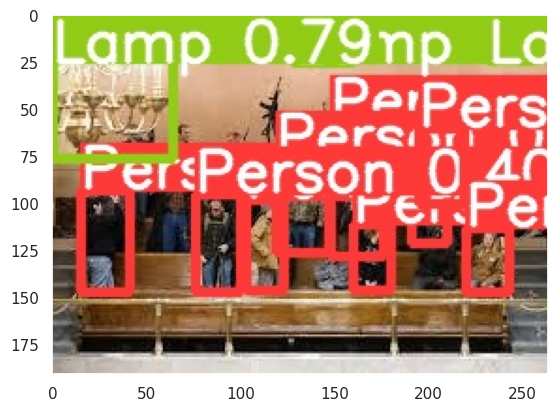

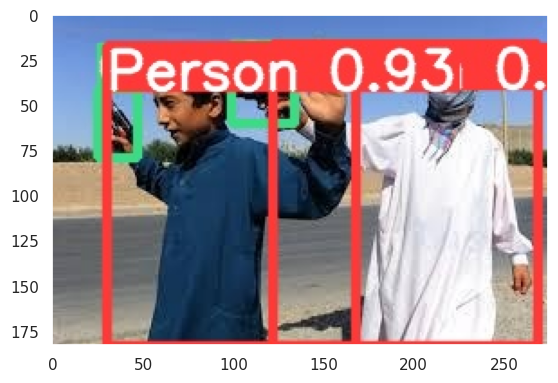

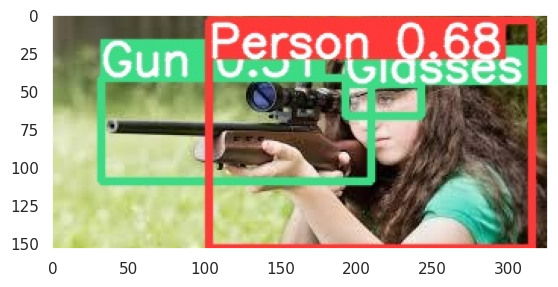

In [96]:
%matplotlib inline
for img in detected_imgs:
    plt.grid(False)
    plt.imshow(plt.imread(img))
    plt.show()

Hmmmm. Better, but not that great. But again, much better than no detections. Oddly, it's hard to find a human pattern to why the gun gets detected or not. I thought initally that handguns were less likely to be caught, however, I see a few in there. 

Next steps would be to get a huge dataset and train more. 300 images is less than peanuts in today's world. It's like, not even a small nibble of a peanut that could be had. 

I'm going to call it here though. What'd we (Maybe just I) learn here:

1.) YOLO is for object detection and people have made it easy to use out of the box.
2.) You need more training data than 300 images or more epochs than 4 to really get a good detection going.
3.) I can read documentation from a 3rd party...but I'm still a bit clueless on stuff.

Well, then...until next week y'all.